# Klein Tunneling of a particle obeying Klein-Gordon Equation

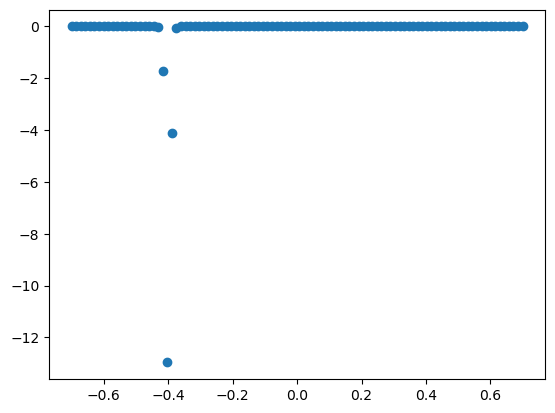

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from numpy.linalg import multi_dot
from IPython.display import HTML

# Define parameters
# c = 137.0
c = 1.0
x0 = -0.4
delta_x = 8e-3
p = 2.3*c
E = 2.5*c**2
m = np.sqrt(E**2 - p**2)
A = 1.0 / (2.0 * np.pi * delta_x**2)**0.25

V0 = 5.0*c**2
w = 0.9/c

# Define the Sauter step potential
# V(x)=0.5*V0*(tanh(x/w)+1)
def V(x, V0, w):
    return V0*0.5*(np.tanh(x/w)+1)

# Define computational grid
N = 100
x_domain = [-0.7, 0.7]

x = np.linspace(x_domain[0], x_domain[1], N) # spatial grid points
dx = (x_domain[1] - x_domain[0]) / (N-1)     # spatial step size

dt = 1.0 / (4*c**2)     # temporal step size

# Initial wave packet
Psi = np.zeros((2,N), dtype='complex')
Psi[0, :] = E + m
Psi[1, :] = m - E
Psi *= 0.5*np.sqrt(m*E) # normalize
Psi *= A    # multiply with weight function

Psi = np.zeros((2,N), dtype='complex')
Psi[0, :] = 1 + E/(m*c**2)
Psi[1, :] = 1 - E/(m*c**2)
Psi *= 0.5*np.sqrt(m*c**2/E) # normalize
g = A * np.exp(-(x-x0)**2 / (4*delta_x**2)) * np.exp(1j*p*x)
Psi *= g    # multiply with weight function

density = Psi[0, :]**2 - Psi[1, :]**2

plt.scatter(x, density)
plt.show()

# # go to real space (position space)
# Psi = dp / np.sqrt(2*np.pi) * np.exp(1j*x*p[0]) * np.fft.ifft(np.exp(1j*x[0]*np.arange(0, N)*dp)*Psi, axis=1)*N

# # real space propagator
# U_1 = np.exp(-0.5*1j*V(x, 2*c**2+1e4, 0.3/c)*dt)

# # construct the free propagator
# U_2 = np.zeros((2, 2, N), dtype='complex')
# for i in range(0, N):
#     Q_11 = (1 + E[i]/(m*c**2))
#     Q_12 = (1 - E[i]/(m*c**2))
#     Q = np.array([ [Q_11, Q_12], [Q_12, Q_11] ])
#     Q_inv = np.array([ [Q_11, -Q_12], [-Q_12, Q_11] ])
#     Q_inv *= 0.25*m*c**2/E[i]
#     U_2[:, :, i] = multi_dot([Q, np.diag([np.exp(-1j*dt*E[i]), np.exp(1j*dt*E[i])]), Q_inv])
#     # U_2[:, :, i] = np.dot(Q, np.dot(np.diag([np.exp(-1j*dt*E[i]), np.exp(+1j*dt*E[i])]), Q_inv))

# # Define the potential barrier
# V0 = 2 *c**2 + 1e4  # potential height
# w = 0.3 / c          # potential width
# V_x = V(x, V0, w)    # compute potential function

# # Normalize V(x) for visualization (scaling factor for visibility)
# V_x = V_x / np.max(V_x) * 28  # Scale to be within (0,5) for plotting

# # Set up the figure and axis
# fig, ax = plt.subplots()
# ax.set_xlim(x_domain[0], x_domain[1])
# ax.set_ylim(0, 30)
# ax.set_xlabel(r'$x$')
# ax.set_ylabel(r'$\Psi(x)^\dagger\Psi(x)$')

# # Plot elements
# line_prob, = ax.plot([], [], color="#266bbd", label=r'$|\Psi(x)|^2$')
# ax.plot(x, V_x, color='black', linestyle='--', label=r'$V(x)$') # potential barrier
# ax.legend(loc='upper left')

# # Initialization function
# def init():
#     line_prob.set_data([], [])
#     return line_prob,

# # initialize propability
# probability_KG = []

# # Update function
# def update(frame):
#     global Psi
#     Psi *= U_1                                      # apply U_1 in real space
#     Psi = np.fft.fft(Psi, axis=1)                   # go to Fourier space
#     Psi = np.einsum('ij...,j...->i...', U_2, Psi)   # apply U_2 in Fourier space
#     Psi = np.fft.ifft(Psi, axis=1)                  # go to real space
#     Psi *= U_1                                      # apply U_1 in real space

#     # compute total probability
#     P_t = np.sum(np.conj(Psi[0,:])*Psi[0,:] - np.conj(Psi[1,:])*Psi[1,:]) * dx
#     probability_KG.append(P_t.real)  # Store probability for plotting

#     line_prob.set_data(x, Psi[0,:].real**2 + Psi[0,:].imag**2 + Psi[1,:].real**2 + Psi[1,:].imag**2)

#     return line_prob,

# # Create animation
# ani = animation.FuncAnimation(fig, update, frames=512, init_func=init, blit=True)

# # Show the animation
# HTML(ani.to_jshtml())
# # plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from numpy.linalg import multi_dot
from IPython.display import HTML

# Define parameters
# c = 137.0
c = 1.0
x0 = -0.4
delta_x = 8e-3
p = 2.3*c
E = 2.5*c**2
m = np.sqrt(E**2 - p**2)
A = 1.0 / (2.0 * np.pi * delta_x**2)**0.25

V0 = 5.0*c**2
w = 0.9/c

# Define the Sauter step potential
# V(x)=0.5*V0*(tanh(x/w)+1)
def V(x, V0, w):
    return V0*0.5*(np.tanh(x/w)+1)

# Define computational grid
N = 100
x_domain = [-0.7, 0.7]

x = np.linspace(x_domain[0], x_domain[1], N) # spatial grid points
dx = (x_domain[1] - x_domain[0]) / (N-1)     # spatial step size

dt = 1.0 / (4*c**2)     # temporal step size

# Initial wave packet
Psi = np.zeros((2,N), dtype='complex')
Psi[0, :] = E + m
Psi[1, :] = m - E
Psi *= 0.5*np.sqrt(m*E) # normalize
Psi *= A    # multiply with weight function

Psi = np.zeros((2,N), dtype='complex')
Psi[0, :] = 1 + E/(m*c**2)
Psi[1, :] = 1 - E/(m*c**2)
Psi *= 0.5*np.sqrt(m*c**2/E) # normalize
g = A * np.exp(-(x-x0)**2 / (4*delta_x**2)) * np.exp(1j*p*x)
Psi *= g    # multiply with weight function

density = Psi[0, :]**2 - Psi[1, :]**2

plt.scatter(x, density)
plt.show()

# # go to real space (position space)
# Psi = dp / np.sqrt(2*np.pi) * np.exp(1j*x*p[0]) * np.fft.ifft(np.exp(1j*x[0]*np.arange(0, N)*dp)*Psi, axis=1)*N

# # real space propagator
# U_1 = np.exp(-0.5*1j*V(x, 2*c**2+1e4, 0.3/c)*dt)

# # construct the free propagator
# U_2 = np.zeros((2, 2, N), dtype='complex')
# for i in range(0, N):
#     Q_11 = (1 + E[i]/(m*c**2))
#     Q_12 = (1 - E[i]/(m*c**2))
#     Q = np.array([ [Q_11, Q_12], [Q_12, Q_11] ])
#     Q_inv = np.array([ [Q_11, -Q_12], [-Q_12, Q_11] ])
#     Q_inv *= 0.25*m*c**2/E[i]
#     U_2[:, :, i] = multi_dot([Q, np.diag([np.exp(-1j*dt*E[i]), np.exp(1j*dt*E[i])]), Q_inv])
#     # U_2[:, :, i] = np.dot(Q, np.dot(np.diag([np.exp(-1j*dt*E[i]), np.exp(+1j*dt*E[i])]), Q_inv))

# # Define the potential barrier
# V0 = 2 *c**2 + 1e4  # potential height
# w = 0.3 / c          # potential width
# V_x = V(x, V0, w)    # compute potential function

# # Normalize V(x) for visualization (scaling factor for visibility)
# V_x = V_x / np.max(V_x) * 28  # Scale to be within (0,5) for plotting

# # Set up the figure and axis
# fig, ax = plt.subplots()
# ax.set_xlim(x_domain[0], x_domain[1])
# ax.set_ylim(0, 30)
# ax.set_xlabel(r'$x$')
# ax.set_ylabel(r'$\Psi(x)^\dagger\Psi(x)$')

# # Plot elements
# line_prob, = ax.plot([], [], color="#266bbd", label=r'$|\Psi(x)|^2$')
# ax.plot(x, V_x, color='black', linestyle='--', label=r'$V(x)$') # potential barrier
# ax.legend(loc='upper left')

# # Initialization function
# def init():
#     line_prob.set_data([], [])
#     return line_prob,

# # initialize propability
# probability_KG = []

# # Update function
# def update(frame):
#     global Psi
#     Psi *= U_1                                      # apply U_1 in real space
#     Psi = np.fft.fft(Psi, axis=1)                   # go to Fourier space
#     Psi = np.einsum('ij...,j...->i...', U_2, Psi)   # apply U_2 in Fourier space
#     Psi = np.fft.ifft(Psi, axis=1)                  # go to real space
#     Psi *= U_1                                      # apply U_1 in real space

#     # compute total probability
#     P_t = np.sum(np.conj(Psi[0,:])*Psi[0,:] - np.conj(Psi[1,:])*Psi[1,:]) * dx
#     probability_KG.append(P_t.real)  # Store probability for plotting

#     line_prob.set_data(x, Psi[0,:].real**2 + Psi[0,:].imag**2 + Psi[1,:].real**2 + Psi[1,:].imag**2)

#     return line_prob,

# # Create animation
# ani = animation.FuncAnimation(fig, update, frames=512, init_func=init, blit=True)

# # Show the animation
# HTML(ani.to_jshtml())
# # plt.show()

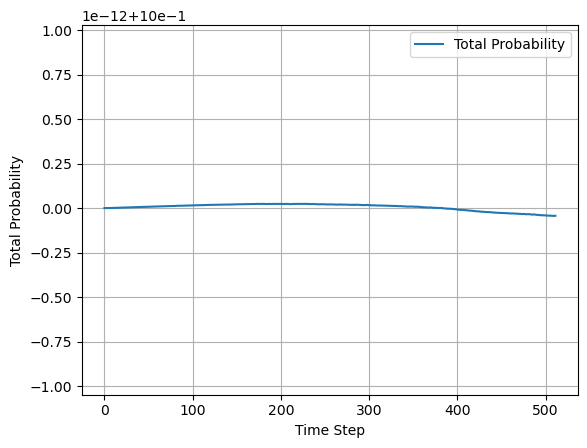

In [3]:
# Plot probability conservation
fig_prob, ax_prob = plt.subplots()
ax_prob.plot(probability_KG, label="Total Probability")
ax_prob.set_xlabel("Time Step")
ax_prob.set_ylabel("Total Probability")
ax_prob.legend()
ax_prob.grid()
plt.show()

# With the probability density written as $\Psi^\dagger\sigma_3\Psi$

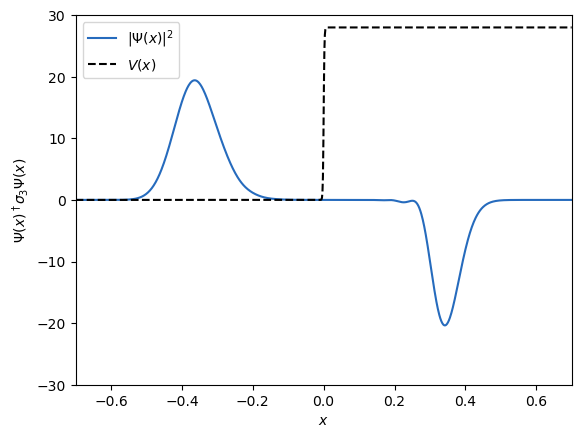

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from numpy.linalg import multi_dot
from IPython.display import HTML

# Define the (smooth) step potential
# V(x)=0.5*V0*(tanh(x/w)+1)
def V(x, V0, w):
    return V0*0.5*(np.tanh(x/w)+1)

# Define computational grid
N = 1024
x_domain = [-0.7, 0.7]

dx = (x_domain[1] - x_domain[0]) / (N-1)     # spatial step size
x = np.linspace(x_domain[0], x_domain[1], N) # spatial grid points

c = 137                 # speed of light in atomic units (h=e=m_e=1)
dt = 1.0 / (4*c**2)     # temporal step size

dp = 2.0*np.pi / (N*dx)             # momentum step size
p = np.linspace(0, (N-1)*dp, N)     # momentum grid points
p[p>0.5*N*dp] -= N*dp               # imposing periodicity
# p = np.sort(p)

# Initial wave packet
m = 1.0     # to be changed to mass of a spin-0 particle
E = np.sqrt(p**2*c**2 + (m**2*c**4))

# Gaussian wave packet with p_mean composed of positive-energy states
x_init = -0.2               # initial position of the wave packet
p_mean = 106.4              # mean momentum
Delta_p = 0.125*c           # momentum width
Psi = np.zeros((2,N), dtype='complex')
Psi[0, :] = 1 + E/(m*c**2)
Psi[1, :] = 1 - E/(m*c**2)
Psi *= 0.5*np.sqrt(m*c**2/E) # normalize
g = 1 / (2*np.pi*Delta_p**2)**0.25 * np.exp(-(p-p_mean)**2 / (4*Delta_p**2)) * np.exp(- 1j*p*x_init)
Psi *= g    # multiply with weight function

# go to real space (position space)
Psi = dp / np.sqrt(2*np.pi) * np.exp(1j*x*p[0]) * np.fft.ifft(np.exp(1j*x[0]*np.arange(0, N)*dp)*Psi, axis=1)*N

# real space propagator
U_1 = np.exp(-0.5*1j*V(x, 2*c**2+1e4, 0.3/c)*dt)

# construct the free propagator
U_2 = np.zeros((2, 2, N), dtype='complex')
for i in range(0, N):
    Q_11 = (1 + E[i]/(m*c**2))
    Q_12 = (1 - E[i]/(m*c**2))
    Q = np.array([ [Q_11, Q_12], [Q_12, Q_11] ])
    Q_inv = np.array([ [Q_11, -Q_12], [-Q_12, Q_11] ])
    Q_inv *= 0.25*m*c**2/E[i]
    U_2[:, :, i] = multi_dot([Q, np.diag([np.exp(-1j*dt*E[i]), np.exp(1j*dt*E[i])]), Q_inv])
    # U_2[:, :, i] = np.dot(Q, np.dot(np.diag([np.exp(-1j*dt*E[i]), np.exp(+1j*dt*E[i])]), Q_inv))

# Define the potential barrier
V0 = 2 *c**2 + 1e4  # potential height
w = 0.3 / c          # potential width
V_x = V(x, V0, w)    # compute potential function

# Normalize V(x) for visualization (scaling factor for visibility)
V_x = V_x / np.max(V_x) * 28  # Scale to be within (0,5) for plotting

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(x_domain[0], x_domain[1])
ax.set_ylim(-30, 30)
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$\Psi(x)^\dagger\sigma_3\Psi(x)$')

# Plot elements
line_prob, = ax.plot([], [], color="#266bbd", label=r'$|\Psi(x)|^2$')
ax.plot(x, V_x, color='black', linestyle='--', label=r'$V(x)$') # potential barrier
ax.legend(loc='upper left')

# Initialization function
def init():
    line_prob.set_data([], [])
    return line_prob,

# initialize propability
probability_KG = []

# Update function
def update(frame):
    global Psi
    Psi *= U_1                                      # apply U_1 in real space
    Psi = np.fft.fft(Psi, axis=1)                   # go to Fourier space
    Psi = np.einsum('ij...,j...->i...', U_2, Psi)   # apply U_2 in Fourier space
    Psi = np.fft.ifft(Psi, axis=1)                  # go to real space
    Psi *= U_1                                      # apply U_1 in real space

    # compute total probability
    P_t = np.sum(np.abs(Psi[0,:])**2 - np.abs(Psi[1,:])**2) * dx
    probability_KG.append(P_t.real)  # Store probability for plotting

    line_prob.set_data(x, np.abs(Psi[0,:])**2 - np.abs(Psi[1,:])**2)

    return line_prob,

# Create animation
ani = animation.FuncAnimation(fig, update, frames=512, init_func=init, blit=True)

# Show the animation
HTML(ani.to_jshtml())
# plt.show()

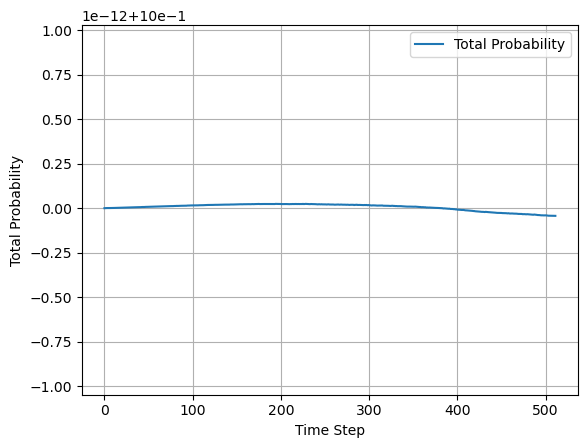

In [4]:
# Plot probability conservation
fig_prob, ax_prob = plt.subplots()
ax_prob.plot(probability_KG, label="Total Probability")
ax_prob.set_xlabel("Time Step")
ax_prob.set_ylabel("Total Probability")
ax_prob.legend()
ax_prob.grid()
plt.show()

# Checking the propagation of the initial gaussian wave packet in free space

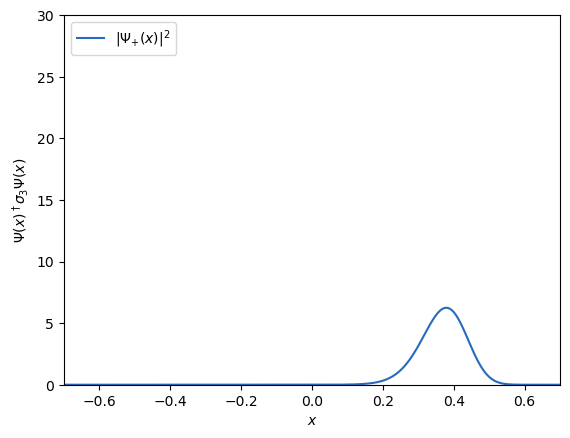

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from numpy.linalg import multi_dot
from IPython.display import HTML

# Define the (smooth) step potential
# V(x)=0.5*V0*(tanh(x/w)+1)
def V(x, V0, w):
    return V0*0.5*(np.tanh(x/w)+1)*0

# Define computational grid
N = 1024
x_domain = [-0.7, 0.7]

dx = (x_domain[1] - x_domain[0]) / (N-1)     # spatial step size
x = np.linspace(x_domain[0], x_domain[1], N) # spatial grid points

c = 137                 # speed of light in atomic units (h=e=m_e=1)
dt = 1.0 / (4*c**2)     # temporal step size

dp = 2.0*np.pi / (N*dx)             # momentum step size
p = np.linspace(0, (N-1)*dp, N)     # momentum grid points
p[p>0.5*N*dp] -= N*dp               # imposing periodicity
# p = np.sort(p)

# Initial wave packet
m = 1.0     # to be changed to mass of a spin-0 particle
E = np.sqrt(p**2*c**2 + (m**2*c**4))

# Gaussian wave packet with p_mean composed of positive-energy states
x_init = -0.2               # initial position of the wave packet
p_mean = 106.4              # mean momentum
Delta_p = 0.125*c           # momentum width
Psi = np.zeros((2,N), dtype='complex')
Psi[0, :] = 1 + E/(m*c**2)
Psi[1, :] = 1 - E/(m*c**2)
Psi *= 0.5*np.sqrt(m*c**2/E) # normalize
g = 1 / (2*np.pi*Delta_p**2)**0.25 * np.exp(-(p-p_mean)**2 / (4*Delta_p**2)) * np.exp(- 1j*p*x_init)
Psi *= g    # multiply with weight function

# go to real space (position space)
Psi = dp / np.sqrt(2*np.pi) * np.exp(1j*x*p[0]) * np.fft.ifft(np.exp(1j*x[0]*np.arange(0, N)*dp)*Psi, axis=1)*N

# real space propagator
U_1 = np.exp(-0.5*1j*V(x, 2*c**2+1e4, 0.3/c)*dt)

# construct the free propagator
U_2 = np.zeros((2, 2, N), dtype='complex')
for i in range(0, N):
    Q_11 = (1 + E[i]/(m*c**2))
    Q_12 = (1 - E[i]/(m*c**2))
    Q = np.array([ [Q_11, Q_12], [Q_12, Q_11] ])
    Q_inv = np.array([ [Q_11, -Q_12], [-Q_12, Q_11] ])
    Q_inv *= 0.25*m*c**2/E[i]
    U_2[:, :, i] = multi_dot([Q, np.diag([np.exp(-1j*dt*E[i]), np.exp(1j*dt*E[i])]), Q_inv])
    # U_2[:, :, i] = np.dot(Q, np.dot(np.diag([np.exp(-1j*dt*E[i]), np.exp(+1j*dt*E[i])]), Q_inv))

# Define the potential barrier
V0 = 2 *c**2 + 1e4  # potential height
w = 0.3 / c          # potential width
V_x = V(x, V0, w)    # compute potential function

# Normalize V(x) for visualization (scaling factor for visibility)
# V_x = V_x / np.max(V_x) * 28  # Scale to be within (0,5) for plotting

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(x_domain[0], x_domain[1])
ax.set_ylim(0, 30)
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$\Psi(x)^\dagger\sigma_3\Psi(x)$')

# Plot elements
line_prob, = ax.plot([], [], color="#266bbd", label=r'$|\Psi_{+}(x)|^2$')
# ax.plot(x, V_x, color='black', linestyle='--', label=r'$V(x)$') # potential barrier
ax.legend(loc='upper left')

# Initialization function
def init():
    line_prob.set_data([], [])
    return line_prob,

# initialize propability
probability_KG = []

# Update function
def update(frame):
    global Psi
    Psi *= U_1                                      # apply U_1 in real space
    Psi = np.fft.fft(Psi, axis=1)                   # go to Fourier space
    Psi = np.einsum('ij...,j...->i...', U_2, Psi)   # apply U_2 in Fourier space
    Psi = np.fft.ifft(Psi, axis=1)                  # go to real space
    Psi *= U_1                                      # apply U_1 in real space

    # compute total probability
    P_t = np.sum(np.abs(Psi[0,:])**2 - np.abs(Psi[1,:])**2) * dx
    probability_KG.append(P_t)  # Store probability for plotting

    line_prob.set_data(x, np.abs(Psi[0,:])**2 - np.abs(Psi[1,:])**2)

    return line_prob,

# Create animation
ani = animation.FuncAnimation(fig, update, frames=512, init_func=init, blit=True)

# Show the animation
HTML(ani.to_jshtml())
# plt.show()

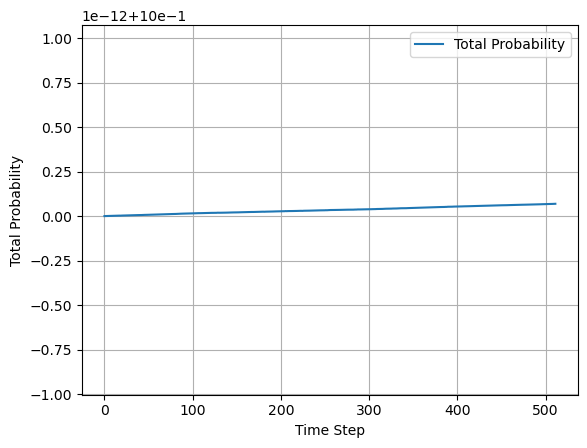

In [4]:
# Plot probability conservation
fig_prob, ax_prob = plt.subplots()
ax_prob.plot(probability_KG, label="Total Probability")
ax_prob.set_xlabel("Time Step")
ax_prob.set_ylabel("Total Probability")
ax_prob.legend()
ax_prob.grid()
plt.show()

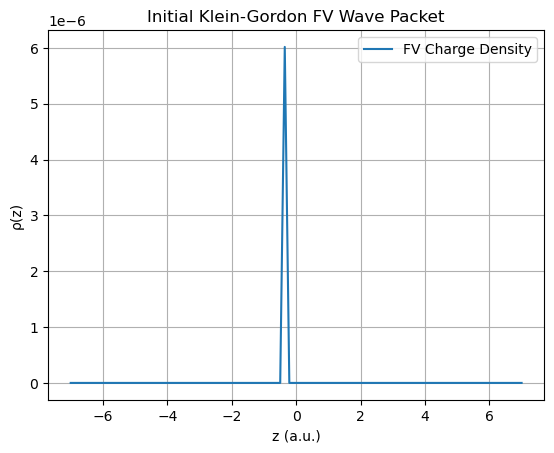

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# Parameters
z0 = -0.4
delta_z = 8e-3
E = 2.5
p = 2.3
m = np.sqrt(E**2 - p**2)

# FV components
alpha = 0.5 * (1 + E / m)
beta = 0.5 * (1 - E / m)

# Normalization constant
A = 1 / (2 * np.pi * delta_z**2)**0.25

# Grid
z = np.linspace(-7.0, 7.0, 100)
phi = A * np.exp(-((z - z0)**2) / (4 * delta_z**2)) * np.exp(1j * p * z)

# Two-component FV spinor
phi1 = alpha * phi
phi2 = beta * phi
rho = np.abs(phi1)**2 - np.abs(phi2)**2  # FV charge density

# Plot charge density
plt.plot(z, rho, label="FV Charge Density")
plt.xlabel("z (a.u.)")
plt.ylabel("ρ(z)")
plt.title("Initial Klein-Gordon FV Wave Packet")
plt.grid()
plt.legend()
plt.show()
